<a href="https://colab.research.google.com/github/Kate-Strydom/cse450/blob/main/Kate_Starter_Bikes.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Import libraries

In [69]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import altair as alt

from sklearn.preprocessing import MinMaxScaler

import tensorflow as tf
from tensorflow import keras

from tensorflow.keras import layers, Sequential
from tensorflow.keras.layers import Dropout, Dense
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score

alt.data_transformers.enable('default', max_rows=None)

DataTransformerRegistry.enable('default')

## Get Data

In [2]:
bikes = pd.read_csv('https://raw.githubusercontent.com/byui-cse/cse450-course/master/data/bikes.csv')

## Data Wrangling

In [3]:
bikes.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
season,16637.0,2.482058,1.085930,1.00,2.0000,2.00,3.0000,4.0
hr,16637.0,11.547875,6.914199,0.00,6.0000,12.00,18.0000,23.0
holiday,16637.0,0.028671,0.166885,0.00,0.0000,0.00,0.0000,1.0
workingday,16637.0,0.684378,0.464777,0.00,0.0000,1.00,1.0000,1.0
weathersit,16637.0,1.415580,0.637298,1.00,1.0000,1.00,2.0000,4.0
hum,16637.0,0.624756,0.193227,0.00,0.4700,0.62,0.7800,1.0
windspeed,16637.0,12.750436,8.168415,0.00,7.0000,13.00,17.0000,57.0
temp_c,16637.0,15.723008,9.041349,-7.06,7.9800,16.44,23.0200,39.0
feels_like_c,16637.0,15.852141,11.322751,-16.00,5.9978,17.00,24.9992,50.0
casual,16637.0,36.471239,49.995203,0.00,4.0000,17.00,50.0000,367.0


In [4]:
bikes.head()

,dteday,season,hr,holiday,workingday,weathersit,hum,windspeed,temp_c,feels_like_c,casual,registered
0,1/1/11,1,0,0,0,1,0.81,0,3.28,3.0014,3,13
1,1/1/11,1,1,0,0,1,0.80,0,2.34,1.9982,8,32
2,1/1/11,1,2,0,0,1,0.80,0,2.34,1.9982,5,27
3,1/1/11,1,3,0,0,1,0.75,0,3.28,3.0014,3,10
4,1/1/11,1,4,0,0,1,0.75,0,3.28,3.0014,0,1


In [5]:
bikes.isna().sum()

dteday          0
season          0
hr              0
holiday         0
workingday      0
weathersit      0
hum             0
windspeed       0
temp_c          0
feels_like_c    0
casual          0
registered      0
dtype: int64

In [6]:
bikes.shape

(16637, 12)

In [7]:
bikes=bikes.dropna()

### Rename Features

In [8]:
print(bikes['season'].value_counts())
print(bikes['weathersit'].value_counts())

3    4496
2    4409
1    3980
4    3752
Name: season, dtype: int64
1    11078
2     4207
3     1349
4        3
Name: weathersit, dtype: int64


In [9]:
# rename the columns as the one in clean data to use merge by this column
bikes.rename(columns={'hum': 'humidity_percentage'}, inplace = True)
bikes.rename(columns={'temp_c': 'temperature_celsius'}, inplace = True)
bikes.rename(columns={'feels_like_c': 'feels_like_temperature_celsius'}, inplace = True)
bikes.head()

,dteday,season,hr,holiday,workingday,weathersit,humidity_percentage,windspeed,temperature_celsius,feels_like_temperature_celsius,casual,registered
0,1/1/11,1,0,0,0,1,0.81,0,3.28,3.0014,3,13
1,1/1/11,1,1,0,0,1,0.80,0,2.34,1.9982,8,32
2,1/1/11,1,2,0,0,1,0.80,0,2.34,1.9982,5,27
3,1/1/11,1,3,0,0,1,0.75,0,3.28,3.0014,3,10
4,1/1/11,1,4,0,0,1,0.75,0,3.28,3.0014,0,1


In [10]:
print(bikes['season'].value_counts())
print(bikes['weathersit'].value_counts())

3    4496
2    4409
1    3980
4    3752
Name: season, dtype: int64
1    11078
2     4207
3     1349
4        3
Name: weathersit, dtype: int64


### Target Feature

In [11]:
bikes['bike_riders'] = bikes['casual'] + bikes['registered']
bikes.head()

,dteday,season,hr,holiday,workingday,weathersit,humidity_percentage,windspeed,temperature_celsius,feels_like_temperature_celsius,casual,registered,bike_riders
0,1/1/11,1,0,0,0,1,0.81,0,3.28,3.0014,3,13,16
1,1/1/11,1,1,0,0,1,0.80,0,2.34,1.9982,8,32,40
2,1/1/11,1,2,0,0,1,0.80,0,2.34,1.9982,5,27,32
3,1/1/11,1,3,0,0,1,0.75,0,3.28,3.0014,3,10,13
4,1/1/11,1,4,0,0,1,0.75,0,3.28,3.0014,0,1,1


### Time Features

In [12]:
# remove timestamp on training data 
bikes['date'] = pd.to_datetime(bikes['dteday'])
print ("min sale date, max sale date")
print(bikes['date'].min(), bikes['date'].max())

min sale date, max sale date
2011-01-01 00:00:00 2012-11-30 00:00:00


In [13]:
## day of month
#bikes['dayofmonth'] = pd.DatetimeIndex(bikes['date']).day

In [14]:
# month
bikes['month'] = pd.DatetimeIndex(bikes['date']).month
# week day name
bikes['day_name'] = pd.DatetimeIndex(bikes['date']).day_name()
# day of year
bikes['day_of_year'] = pd.DatetimeIndex(bikes['date']).dayofyear


In [ ]:
# day of week
#bikes['dayofweek'] = pd.DatetimeIndex(bikes['date']).dayofweek

In [15]:
# week day name
bikes['day_name'] = pd.DatetimeIndex(bikes['date']).day_name()

In [ ]:
# month of year
#bikes['month_name'] = pd.DatetimeIndex(bikes['date']).month_name()

In [16]:
# day of year
bikes['day_of_year'] = pd.DatetimeIndex(bikes['date']).dayofyear

In [17]:
# year
bikes['year'] = pd.DatetimeIndex(bikes['date']).year

In [ ]:
bikes.head()

,dteday,season,hr,holiday,workingday,weathersit,humidity_percentage,windspeed,temperature_celsius,feels_like_temperature_celsius,casual,registered,bike_riders,date,month,day_name,day_of_year,year
0,1/1/11,1,0,0,0,1,0.81,0,3.28,3.0014,3,13,16,2011-01-01,1,Saturday,1,2011
1,1/1/11,1,1,0,0,1,0.80,0,2.34,1.9982,8,32,40,2011-01-01,1,Saturday,1,2011
2,1/1/11,1,2,0,0,1,0.80,0,2.34,1.9982,5,27,32,2011-01-01,1,Saturday,1,2011
3,1/1/11,1,3,0,0,1,0.75,0,3.28,3.0014,3,10,13,2011-01-01,1,Saturday,1,2011
4,1/1/11,1,4,0,0,1,0.75,0,3.28,3.0014,0,1,1,2011-01-01,1,Saturday,1,2011


In [ ]:
# number of riders the day hour before & replace NAN
#bikes['bike_riders_hour_before'] = bikes['bike_riders'].shift(1).fillna(bikes['bike_riders'].min())


In [ ]:
# add date and hr
#bikes['datetimestamp'] = pd.to_datetime(bikes.date) + pd.to_timedelta(bikes.hr, unit='h')

In [18]:
bikes.head()

,dteday,season,hr,holiday,workingday,weathersit,humidity_percentage,windspeed,temperature_celsius,feels_like_temperature_celsius,casual,registered,bike_riders,date,month,day_name,day_of_year,year
0,1/1/11,1,0,0,0,1,0.81,0,3.28,3.0014,3,13,16,2011-01-01,1,Saturday,1,2011
1,1/1/11,1,1,0,0,1,0.80,0,2.34,1.9982,8,32,40,2011-01-01,1,Saturday,1,2011
2,1/1/11,1,2,0,0,1,0.80,0,2.34,1.9982,5,27,32,2011-01-01,1,Saturday,1,2011
3,1/1/11,1,3,0,0,1,0.75,0,3.28,3.0014,3,10,13,2011-01-01,1,Saturday,1,2011
4,1/1/11,1,4,0,0,1,0.75,0,3.28,3.0014,0,1,1,2011-01-01,1,Saturday,1,2011


### One Hot Encoding

In [19]:
# categorical feautures  season : season (1:winter, 2:spring, 3:summer, 4:fall) 
bikes['season']=bikes['season'].map({1:'winter', 2:'spring', 3:'summer', 4:'fall'})
# weathersit weathersit : - 1: Clear, Few clouds, Partly cloudy, Partly cloudy ,- 2: Mist + Cloudy, Mist + Broken clouds, Mist + Few clouds, Mist , - 3: Light Snow, Light Rain + Thunderstorm + Scattered clouds, Light Rain + Scattered clouds , - 4: Heavy Rain + Ice Pallets + Thunderstorm + Mist, Snow + Fog 
bikes['weathersit']=bikes['weathersit'].map({1:'clear', 2:'mist_cloudy', 3:'light_rain_snow', 4:'heavy_rain_snow'})

In [20]:
df = pd.get_dummies(bikes, columns = ['season', 'weathersit'], prefix='', prefix_sep='')
df.tail()
 #'day_name', 'month_name'

,dteday,hr,holiday,workingday,humidity_percentage,windspeed,temperature_celsius,feels_like_temperature_celsius,casual,registered,...,day_of_year,year,fall,spring,summer,winter,clear,heavy_rain_snow,light_rain_snow,mist_cloudy
16632,11/30/12,19,0,1,0.66,0,7.04,7.0010,18,359,...,335,2012,1,0,0,0,1,0,0,0
16633,11/30/12,20,0,1,0.66,0,7.04,7.0010,12,233,...,335,2012,1,0,0,0,1,0,0,0
16634,11/30/12,21,0,1,0.75,6,6.10,5.0012,14,169,...,335,2012,1,0,0,0,1,0,0,0
16635,11/30/12,22,0,1,0.75,0,6.10,5.9978,18,145,...,335,2012,1,0,0,0,1,0,0,0
16636,11/30/12,23,0,1,0.75,6,6.10,5.0012,11,99,...,335,2012,1,0,0,0,0,0,0,1


In [21]:
drop_features = ['dteday', 'casual', 'registered', 'date',  'heavy_rain_snow']
df = df.drop(columns=drop_features)
df.tail()

,hr,holiday,workingday,humidity_percentage,windspeed,temperature_celsius,feels_like_temperature_celsius,bike_riders,month,day_name,day_of_year,year,fall,spring,summer,winter,clear,light_rain_snow,mist_cloudy
16632,19,0,1,0.66,0,7.04,7.0010,377,11,Friday,335,2012,1,0,0,0,1,0,0
16633,20,0,1,0.66,0,7.04,7.0010,245,11,Friday,335,2012,1,0,0,0,1,0,0
16634,21,0,1,0.75,6,6.10,5.0012,183,11,Friday,335,2012,1,0,0,0,1,0,0
16635,22,0,1,0.75,0,6.10,5.9978,163,11,Friday,335,2012,1,0,0,0,1,0,0
16636,23,0,1,0.75,6,6.10,5.0012,110,11,Friday,335,2012,1,0,0,0,0,0,1


In [22]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 16637 entries, 0 to 16636
Data columns (total 19 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   hr                              16637 non-null  int64  
 1   holiday                         16637 non-null  int64  
 2   workingday                      16637 non-null  int64  
 3   humidity_percentage             16637 non-null  float64
 4   windspeed                       16637 non-null  int64  
 5   temperature_celsius             16637 non-null  float64
 6   feels_like_temperature_celsius  16637 non-null  float64
 7   bike_riders                     16637 non-null  int64  
 8   month                           16637 non-null  int64  
 9   day_name                        16637 non-null  object 
 10  day_of_year                     16637 non-null  int64  
 11  year                            16637 non-null  int64  
 12  fall                            

### Check Outliers

In [23]:
# print out largest values
print(bikes['temperature_celsius'].nlargest(n=5))
print(bikes['feels_like_temperature_celsius'].nlargest(n=5))
print(bikes['windspeed'].nlargest(n=5))

13163    39.00
12972    38.06
4768     37.12
4934     37.12
4936     37.12
Name: temperature_celsius, dtype: float64
4768    50.0000
4767    48.9968
4769    48.9968
4766    46.9970
4745    44.9972
Name: feels_like_temperature_celsius, dtype: float64
4315    57
4316    57
5635    56
1259    54
9956    54
Name: windspeed, dtype: int64


temperature_celsius potentially has some outliers

In [24]:
# box and whisker plot Temperature in Celsius by Month

alt.Chart(df).mark_boxplot().encode(
    x='month:O',
    y='temperature_celsius:Q'
).properties(width = 400, height= 400, title = 'Temperature in Celsius by Month')

# extent='min-max'

alt.Chart(...)

In [25]:
# box and whisker plot Feels like Temperature in Celsius by Month

alt.Chart(df).mark_boxplot().encode(
    x='month:O',
    y='feels_like_temperature_celsius:Q'
).properties(width = 400, height= 400, title = 'Feels Like Temperature in Celsius by Month')

alt.Chart(...)

In [26]:
# box and whisker plot Feels like Temperature in Celsius by Month

alt.Chart(df).mark_boxplot().encode(
    x='temperature_celsius:O',
    y='bike_riders:Q'
).properties(width = 1200, height= 400, title = 'Bike Users by Temperature in Celsius')

alt.Chart(...)

we can exclude 38.06 C and 39 C for temperature in Celsius

In [27]:
# box and whisker plot Feels like Temperature in Celsius by Month
alt.Chart(df).mark_boxplot().encode(
    x='feels_like_temperature_celsius:O',
    y='bike_riders:Q'
).properties(width = 1200, height= 400, title = 'Bike Users by Feels Like Temperature in Celsius')

alt.Chart(...)

Exclude feels like temperatures greater than 44.9972 C

In [28]:
# box and whisker plot Feels like Temperature in Celsius by Month

alt.Chart(df).mark_boxplot().encode(
    x='windspeed:O',
    y='bike_riders:Q'
).properties(width = 1200, height= 400, title = 'Bike Users by Windspeed in Celsius')

alt.Chart(...)

In [29]:
# print out largest values
print(bikes['temperature_celsius'].nlargest(n=5))
print(bikes['feels_like_temperature_celsius'].nlargest(n=5))
print(bikes['windspeed'].nlargest(n=5))

13163    39.00
12972    38.06
4768     37.12
4934     37.12
4936     37.12
Name: temperature_celsius, dtype: float64
4768    50.0000
4767    48.9968
4769    48.9968
4766    46.9970
4745    44.9972
Name: feels_like_temperature_celsius, dtype: float64
4315    57
4316    57
5635    56
1259    54
9956    54
Name: windspeed, dtype: int64


In [30]:
df.shape

(16637, 19)

In [31]:
# exclude outliers from the data

bike = df[(df['feels_like_temperature_celsius'] <= 44.9972) & (df['temperature_celsius'] <= 37.12)]
bike.shape

(16631, 19)

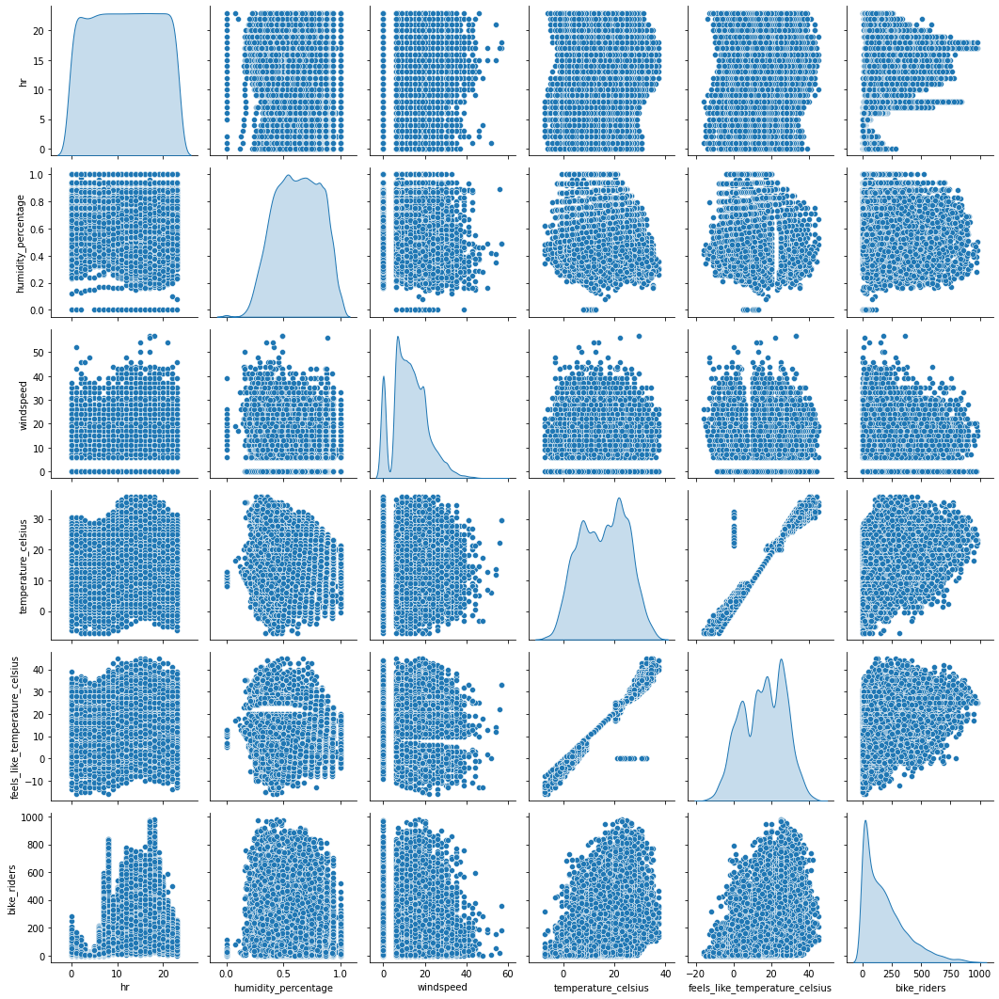

In [32]:
sns.pairplot(bike[['hr', 'humidity_percentage', 'windspeed', 'temperature_celsius', 'feels_like_temperature_celsius', 'bike_riders']], diag_kind='kde')

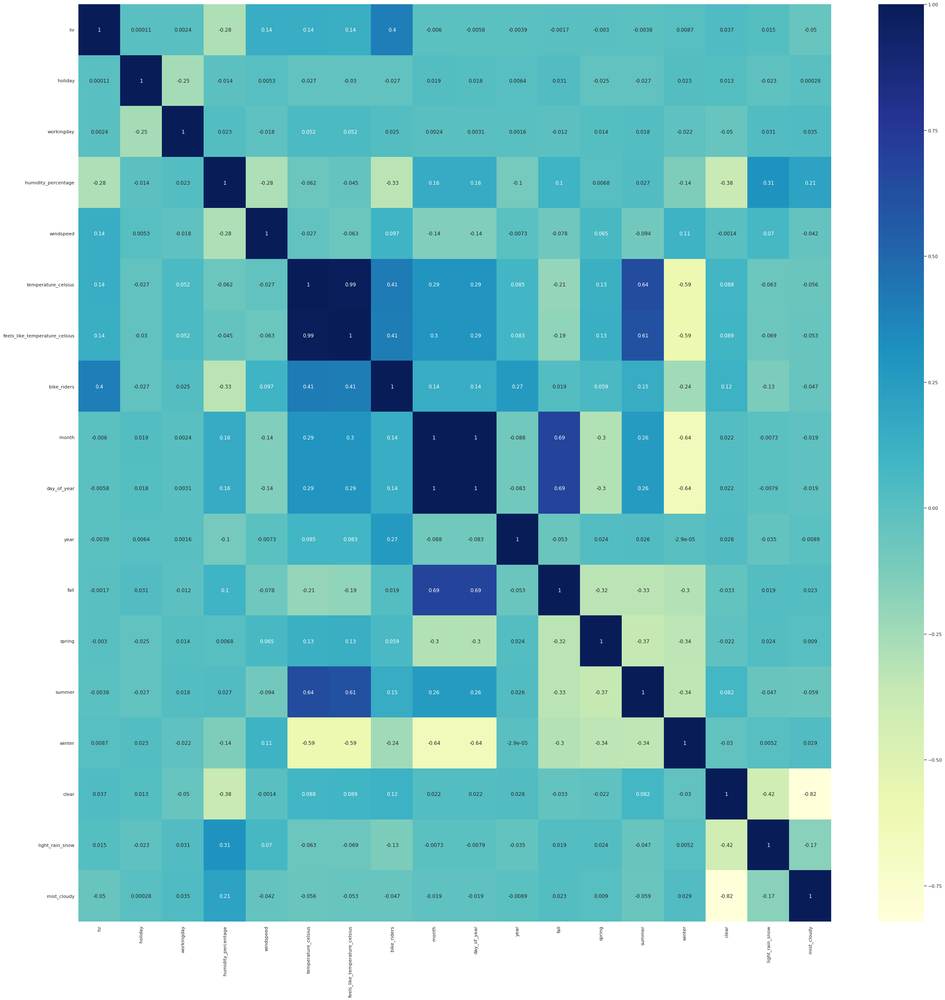

In [33]:
sns.set(rc = {'figure.figsize':(40,40)})

# plotting correlation heatmap
dataplot = sns.heatmap(bike.corr(), cmap="YlGnBu", annot=True)
  
# displaying heatmap
plt.show()

## Split into Train & Test 

In [34]:
#train_dataset = bike.sample(frac=0.8, random_state=0)
#test_dataset = bike.drop(train_dataset.index)
X = bike.drop(columns = ['bike_riders', 'day_name'])
y = bike['bike_riders']

In [35]:
X_test, X_train, y_test, y_train = train_test_split(X, y, test_size=0.3, random_state=42)

In [36]:
y_train

4506     239
13788    865
12382      5
9519     140
4804      60
        ... 
6998      21
9357     306
6141     317
7567      46
467       78
Name: bike_riders, Length: 4990, dtype: int64

In [37]:
X_train

,hr,holiday,workingday,humidity_percentage,windspeed,temperature_celsius,feels_like_temperature_celsius,month,day_of_year,year,fall,spring,summer,winter,clear,light_rain_snow,mist_cloudy
4506,16,0,1,0.56,26,32.42,40.0010,7,192,2011,0,0,1,0,1,0,0
13788,17,0,1,0.52,17,30.54,34.9982,8,215,2012,0,0,1,0,1,0,0
12382,3,0,1,0.82,13,15.50,15.9968,6,157,2012,0,1,0,0,0,1,0
9519,14,0,1,0.35,11,10.80,11.0006,2,37,2012,0,0,0,1,1,0,0
4804,2,0,0,0.63,6,29.60,36.0014,7,205,2011,0,0,1,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6998,5,0,1,0.87,0,9.86,9.9974,10,297,2011,1,0,0,0,1,0,0
9357,19,0,1,0.45,7,6.10,5.0012,1,30,2012,0,0,0,1,1,0,0
6141,11,0,0,0.68,15,16.44,17.0000,9,261,2011,0,0,1,0,1,0,0
7567,22,0,1,0.88,15,11.74,11.9972,11,320,2011,1,0,0,0,0,1,0


## Inspect the Data 

In [ ]:
#X_train.info()

## Normalize Features

In [38]:
#@title Convert raw values to their Z-scores 

# Calculate the Z-scores of each column in the training set:
X_train_mean = X_train.mean()
X_train_std = X_train.std()
X_train_norm = (X_train- X_train_mean)/X_train_std

# Calculate the Z-scores of each column in the test set.
X_test_mean = X_test.mean()
X_test_std = X_test.std()
X_test_norm = (X_test- X_test_mean)/X_test_std

print("Standardize the values.")

Standardize the values.


In [39]:
X_train_norm.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4990 entries, 4506 to 467
Data columns (total 17 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   hr                              4990 non-null   float64
 1   holiday                         4990 non-null   float64
 2   workingday                      4990 non-null   float64
 3   humidity_percentage             4990 non-null   float64
 4   windspeed                       4990 non-null   float64
 5   temperature_celsius             4990 non-null   float64
 6   feels_like_temperature_celsius  4990 non-null   float64
 7   month                           4990 non-null   float64
 8   day_of_year                     4990 non-null   float64
 9   year                            4990 non-null   float64
 10  fall                            4990 non-null   float64
 11  spring                          4990 non-null   float64
 12  summer                          

In [40]:
X_train_norm.head()

,hr,holiday,workingday,humidity_percentage,windspeed,temperature_celsius,feels_like_temperature_celsius,month,day_of_year,year,fall,spring,summer,winter,clear,light_rain_snow,mist_cloudy
4506,0.641519,-0.169883,0.683463,-0.331245,1.616673,1.847363,2.136960,0.210154,0.153814,-0.947946,-0.542553,-0.591949,1.625363,-0.559549,0.712995,-0.303913,-0.581149
13788,0.787093,-0.169883,0.683463,-0.538138,0.513290,1.639093,1.693383,0.511581,0.380285,1.054701,-0.542553,-0.591949,1.625363,-0.559549,0.712995,-0.303913,-0.581149
12382,-1.250948,-0.169883,0.683463,1.013555,0.022898,-0.027067,0.008612,-0.091274,-0.190816,1.054701,-0.542553,1.688997,-0.615124,-0.559549,-1.402253,3.289753,-0.581149
9519,0.350370,-0.169883,0.683463,-1.417430,-0.222298,-0.547742,-0.434379,-1.296985,-1.372405,1.054701,-0.542553,-0.591949,-0.615124,1.786795,0.712995,-0.303913,-0.581149
4804,-1.396522,-0.169883,-1.462843,0.030816,-0.835288,1.534958,1.782333,0.210154,0.281819,-0.947946,-0.542553,-0.591949,1.625363,-0.559549,0.712995,-0.303913,-0.581149


# Build a Regression Neural Network


In [68]:
from sklearn.preprocessing import MinMaxScaler

# fit scaler on training data
norm = MinMaxScaler().fit(X_train)

# transform training data
X_train = norm.transform(X_train)

# transform testing data
X_test = norm.transform(X_test)

In [42]:
len(X_train[0])

17

In [70]:
from keras.regularizers import l1
model = Sequential()
model.add(Dense(64, input_dim=len(X_train[0]), activation='relu')) # activity_regularizer=l1(0.01)
model.add(Dropout(0.25))
model.add(Dense(16, activation='relu'))
model.add(Dense(8, activation='relu'))
model.add(Dense(1, activation='relu'))

In [71]:
model.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_16 (Dense)            (None, 64)                1152      
                                                                 
 dropout_4 (Dropout)         (None, 64)                0         
                                                                 
 dense_17 (Dense)            (None, 16)                1040      
                                                                 
 dense_18 (Dense)            (None, 8)                 136       
                                                                 
 dense_19 (Dense)            (None, 1)                 9         
                                                                 
Total params: 2,337
Trainable params: 2,337
Non-trainable params: 0
_________________________________________________________________


In [72]:
opt = keras.optimizers.Adam(learning_rate=0.001)
#opt = keras.optimizers.Adam()
model.compile(loss="mean_squared_error", optimizer=opt, metrics=['mse'])

In [73]:
early_stop = keras.callbacks.EarlyStopping(monitor='val_mse', patience=30)

history = model.fit(X_train, y_train, epochs=1000, validation_split=.35, verbose=0 ,batch_size=50, callbacks=[early_stop],shuffle=False)

hist = pd.DataFrame(history.history)
print("model completed")

model completed


In [74]:
hist

,loss,mse,val_loss,val_mse
0,65573.562500,65573.562500,64729.746094,64729.746094
1,53295.398438,53295.398438,40795.187500,40795.187500
2,30114.787109,30114.787109,28935.898438,28935.898438
3,27018.521484,27018.521484,27926.070312,27926.070312
4,25932.277344,25932.279297,26960.808594,26960.802734
...,...,...,...,...
893,3550.702393,3550.702393,3809.949707,3809.949707
894,3656.533203,3656.533203,3785.474854,3785.474854
895,3813.858154,3813.858154,3804.443359,3804.443359
896,3721.830078,3721.830078,3717.937500,3717.937500


In [75]:
# h = hist
hist = hist.reset_index()
# h

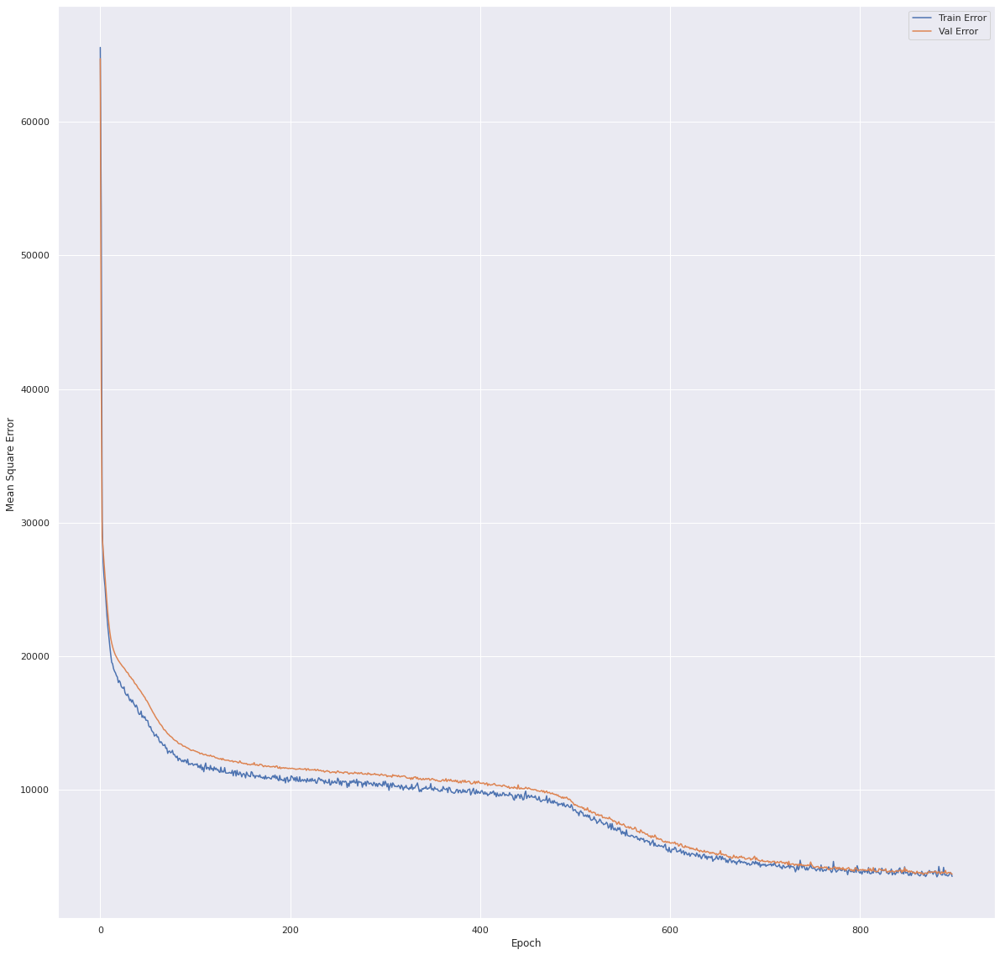

In [76]:
def plot_history():
    plt.figure()
    plt.xlabel('Epoch')
    plt.ylabel('Mean Square Error ')
    plt.plot(hist['index'], hist['mse'], label='Train Error')
    plt.plot(hist['index'], hist['val_mse'], label = 'Val Error')
    plt.legend()
    # plt.ylim([0,50])

sns.set(rc = {'figure.figsize':(20,20)})
plot_history()

In [77]:
predictions = np.round(model.predict(X_test),1)
predictions

array([[206.6],
       [ 33.4],
       [310.9],
       ...,
       [259.6],
       [ 93.2],
       [302.4]], dtype=float32)

In [78]:
result = mean_squared_error(y_test, predictions, squared=False)
result

59.51766621410524

In [79]:
r2 = r2_score(y_test,predictions)
r2

0.8953228079494638

   predictions  actual  difference  difference_change_%
0   206.600006     251   44.399994             0.176892
1    33.400002      28   -5.400002            -0.192857
2   310.899994     144 -166.899994            -1.159028
3    72.400002      41  -31.400002            -0.765854
4    59.200001      32  -27.200001            -0.850000
        predictions        actual    difference  difference_change_%
count  11641.000000  11641.000000  11641.000000         11641.000000
mean     192.326538    190.983249     -1.343476            -0.332195
std      170.199020    183.966403     59.505057             1.300999
min        0.000000      1.000000   -433.500000           -38.000000
25%       49.400002     40.000000    -26.900024            -0.348837
50%      154.899994    143.000000     -3.500000            -0.042260
75%      285.399994    283.000000     20.500000             0.144604
max      885.000000    977.000000    410.800003             1.000000


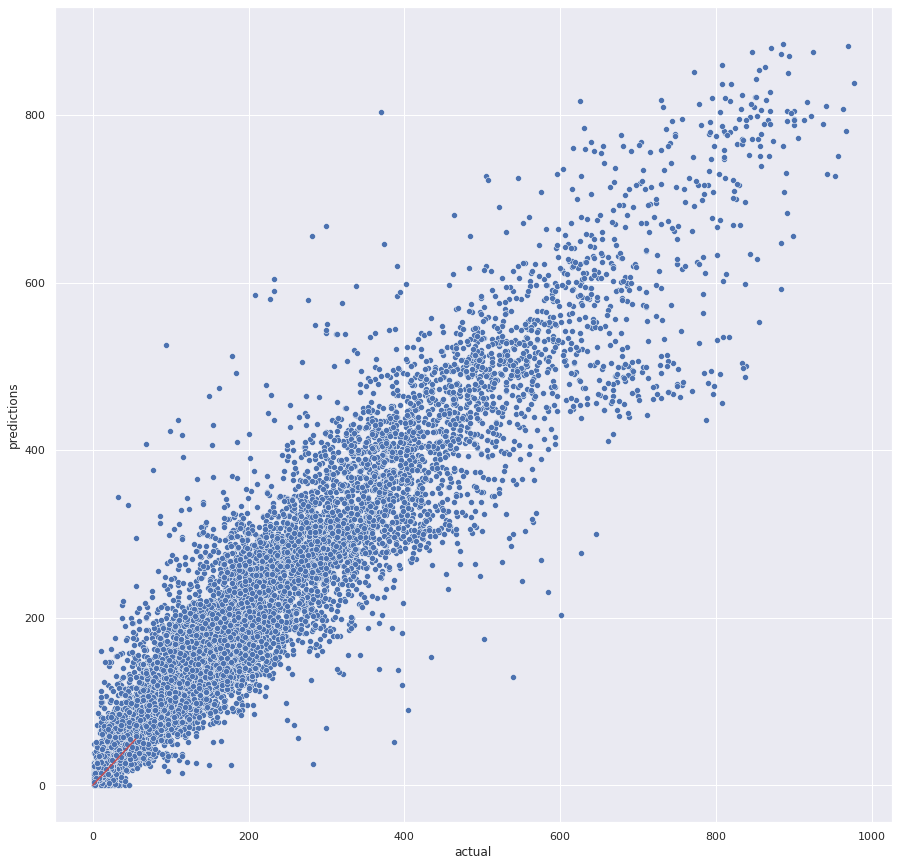

In [80]:
pred = pd.DataFrame(predictions,columns=['predictions'])
pred
pred['actual'] = y_test.tolist()
pred

pred['difference'] = pred['actual']-pred['predictions']
pred

pred['difference_change_%'] = (pred['actual']-pred['predictions'])/pred['actual']
print(pred.head())
print(pred.describe())

sns.set(rc = {'figure.figsize':(15,15)})

import seaborn as sns
xlims =(0,55)
ax = sns.scatterplot(data=pred,x='actual',y='predictions')
ax.plot(xlims,xlims, color='r')
plt.show()

##Significant Feature of the Black Box


In [81]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 16637 entries, 0 to 16636
Data columns (total 19 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   hr                              16637 non-null  int64  
 1   holiday                         16637 non-null  int64  
 2   workingday                      16637 non-null  int64  
 3   humidity_percentage             16637 non-null  float64
 4   windspeed                       16637 non-null  int64  
 5   temperature_celsius             16637 non-null  float64
 6   feels_like_temperature_celsius  16637 non-null  float64
 7   bike_riders                     16637 non-null  int64  
 8   month                           16637 non-null  int64  
 9   day_name                        16637 non-null  object 
 10  day_of_year                     16637 non-null  int64  
 11  year                            16637 non-null  int64  
 12  fall                            

In [82]:
df.drop("bike_riders", axis=1).median()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  """Entry point for launching an IPython kernel.


hr                                  12.00
holiday                              0.00
workingday                           1.00
humidity_percentage                  0.62
windspeed                           13.00
temperature_celsius                 16.44
feels_like_temperature_celsius      17.00
month                                6.00
day_of_year                        176.00
year                              2011.00
fall                                 0.00
spring                               0.00
summer                               0.00
winter                               0.00
clear                                1.00
light_rain_snow                      0.00
mist_cloudy                          0.00
dtype: float64

In [83]:
#create variable to store min and mac value for temperature_celsius
minimum, maximum = df["temperature_celsius"].min(), df["temperature_celsius"].max()

In [87]:
# create an eveny space array of 100 values between min and max
arr = np.arange(minimum, maximum, (maximum- minimum)/100)

In [88]:
# Now create lst of all inputs
lst = []
 
# loop over each variation generated in array
for variation in arr:
  all_vals = list(df.drop("bike_riders", axis=1).median().values)
  
  #replace 5th value with variation
  all_vals[5] = variation

  #append variation with ceteris paribus to list of inputs
  lst.append(all_vals)

# transform lst into numpy array to fit model format for evaluation

lst = np.array(lst)
lst

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None'

array([[12.,  0.,  1., ...,  1.,  0.,  0.],
       [12.,  0.,  1., ...,  1.,  0.,  0.],
       [12.,  0.,  1., ...,  1.,  0.,  0.],
       ...,
       [12.,  0.,  1., ...,  1.,  0.,  0.],
       [12.,  0.,  1., ...,  1.,  0.,  0.],
       [12.,  0.,  1., ...,  1.,  0.,  0.]])

In [90]:
# scale our values
lst = norm.transform(lst)
#submit to model
predictions = model.predict(lst)

In [95]:
plt.figure(figsize = (12, 6))

sns.lineplot(test_values, predictions.flatten(), color='r')
plt.xlabel("temperature_celsius")
plt.ylabel("bike_riders")
plt.ylim(0, 10000)

plt.twinx()
sns.distplot(df['temperature_celsius'], kde=False, bins = 10)
plt.ylabel("Distribution of Bike Riders per Day per Hour (blue histogram)", labelpad=7)



NameError: ignored

<Figure size 864x432 with 0 Axes>

In [96]:
impact_dct = {}

for x,y in dct.items():
  df_feature = pd.DataFrame.from_dict(dct[x])
  impact = abs(y_train.max()- y_train.min())
  impact_dct[x] = impact

NameError: ignored

In [ ]:
pd.DataFrame.from_dict(impact_dct, orient='index', columns- )